# Twitter Sentiment Analysis on Apple and Google Products



## Overview and Business Understanding

Apple and Google are tech giants competing across multiple markets, including smartphones, tablets, and smart home devices, with contrasting approaches. Apple emphasizes a closed, premium ecosystem, while Google focuses on accessibility and cross-platform solutions. 

To aid stakeholders like marketers, product teams, and retailers, a proposed solution involves conducting a Twitter sentiment analysis on Apple and Google products. This analysis will classify tweets as positive, negative, or neutral and identify consumer sentiment trends. The insights aim to enhance marketing strategies, refine product development, and improve customer engagement, ultimately strengthening brand loyalty and product offerings.

## Problem Statement

**Group Six Company** recognizes the value of understanding consumer opinions shared on social media. Tasked by Apple, a global tech leader, we are analyzing over 9,000 human-annotated tweets to classify sentiment as positive, negative, or neutral using **Natural Language Processing (NLP)**. The project aims to uncover actionable insights that will inform Apple’s marketing and product development strategies. By understanding customer perceptions, we aim to help Apple refine its communication, enhance satisfaction, and maintain its leadership in the tech industry.



## Objective

### Main Objective

 - Build a Natural Language Processing (NLP) model that can rate the sentiment of a Tweet based on its content. 



### Secondary Objectives

 - Analyze and Compare Sentiment for Apple vs. Google Products
 - Identify Key Drivers of Positive and Negative Sentiment
 - Monitor and Track Sentiment Trends Over Time
 
 - Gather insights into customer preferences, opinions, and emerging trends
 


## Metrics of Success

- **Accuracy**: Measures the proportion of correctly classified tweets. Useful for overall performance but less effective for imbalanced datasets.
 - **Formula**: (True Positives + True Negatives)/Total Samples
 - **Goal**: Achieve at least 85% accuracy on a balanced test dataset.
 

- **Recall**: Focuses on identifying all actual positive cases.
 - **Formula**: True Positives/(True Positives + False Negatives)
 - **Goal**: Achieve at least 85% recall on a balanced test dataset.
 - **Importance**: Critical when false negatives are costly.
  
 

- **Precision**: Evaluates the proportion of correctly predicted positive cases out of all positive predictions.
 - **Formula**: True Positives / (True Positives + False Positives)
  - **Goal**: Achieve at least 85% precision on a balanced test dataset.
 - **Importance**: Key when false positives are problematic.
 
 

- **F1 Score**:Balances precision and recall as their harmonic mean.
 - **Formula**: 2 ×(Precision × Recall) /(Precision + Recall)
 - **Goal**: Target an F1-score of 0.85 or higher for each sentiment category, ensuring balanced performance. 
 - **Importance**: Effective for imbalanced datasets where both false positives and false negatives matter.




## Data Understanding

The Twitter Dataset used in in this analysis has been sourced from **CrowdFlower** accessible through the link below: https://data.world/crowdflower/brands-and-product-emotions)

It contains roughly 9,000 Tweets which have been evaluated for sentiment by human raters, with the majority focusing on products from Apple and Google. Each tweet has been classified as either positive, negative or neutral. The dataset was collected during the 2013 South by SouthWest (SXSW) conference which is known for showcasing the latest technology. As such, it not only provides a unique setting to effectively capture the real time consumer reactions to brands but also provides an environment where customers can compare products from leading companies with reduced individual biases.



### Import relevant libraries
We will begin by importing all the relevant libraries that we will be using for this analysis. These are provided below:

In [1]:
#Importing all the relevant libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder



import nltk
nltk.download('wordnet')
from nltk.tokenize import RegexpTokenizer
from nltk import FreqDist
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.tokenize import sent_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk import pos_tag
from nltk import TweetTokenizer
import re
import unicodedata
import string
from collections import Counter



from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import silhouette_score, accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score,confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.pipeline import Pipeline

from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.over_sampling import RandomOverSampler
from imblearn.pipeline import Pipeline

from xgboost import XGBClassifier

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


### Load Data

We will proceed with loading the data from our data file  `judge-1377884607_tweet_product_company.csv` 
We will call it `df`

In [2]:
# Importing data_understanding class from DataFunctions script file 
# DataFunctions contains all the functions to be used in the notebook

from DataFunctions import data_understanding as du

df = du("judge-1377884607_tweet_product_company.csv")

### Checking first and last five rows

Next step is to check the first and last five rows to get an idea of how our data looks like.  

In [3]:
#Checking first five rows

du.first_rows(df)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion
2,@swonderlin Can not wait for #iPad 2 also. The...,iPad,Positive emotion
3,@sxsw I hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion
4,@sxtxstate great stuff on Fri #SXSW: Marissa M...,Google,Positive emotion


In [4]:
#Checking last five rows

du.last_rows(df)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
9088,Ipad everywhere. #SXSW {link},iPad,Positive emotion
9089,"Wave, buzz... RT @mention We interrupt your re...",NaN,No emotion toward brand or product
9090,"Google's Zeiger, a physician never reported po...",NaN,No emotion toward brand or product
9091,Some Verizon iPhone customers complained their...,NaN,No emotion toward brand or product
9092,Ï¡Ïàü_ÊÎÒ£Áââ_£â_ÛâRT @...,NaN,No emotion toward brand or product


From the output above, our data is made up of 3 columns listed as follows:

- `tweet_text` - Contains a tweet alongside the username
- `emotion_in_tweet_is_directed_at` - Shows the product being referred to by the tweet
- `is there_an_emotion_directed_at_a_brand_or_product` - Highlights the sentiment i.e. positive, negative etc 

In addition, we observe that some of the tweets are in a language other than English as seen by the tweet in the last row (`row 9092`). 

Also, `emotion_in_tweet_is_directed_at` column appears to have null/missing values. This needs to be addressed as part of data preparation before proceeding with the analysis. 

### Checking shape
Let's have a look at the dimensions of the data we are dealing with. 

The data is made up of 9093 rows and 3 columns as shown below:

In [5]:
#Checking the shape of the data

du.data_shape(df)

(9093, 3)

### Checking info
Let's dive deeper into our data. From the output below we observe that all the data columns are `text` which is what we expect. In addition, `tweet_text` is missing one entry while `emotion_in_tweet_directed_at`has more than 5,000 missing entries. This is consistent with our observations thus far.

In [6]:
#Checking the info on the data, specifically datatypes and missing values

du.data_info(df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9093 entries, 0 to 9092
Data columns (total 3 columns):
 #   Column                                              Non-Null Count  Dtype 
---  ------                                              --------------  ----- 
 0   tweet_text                                          9092 non-null   object
 1   emotion_in_tweet_is_directed_at                     3291 non-null   object
 2   is_there_an_emotion_directed_at_a_brand_or_product  9093 non-null   object
dtypes: object(3)
memory usage: 213.2+ KB


### Description of data

Finally, let's have a breakdown of the summary statistics of the data. 

In [7]:
#Checking summary statistics of the data

du.data_description(df)

,tweet_text,emotion_in_tweet_is_directed_at,is_there_an_emotion_directed_at_a_brand_or_product
count,9092,3291,9093
unique,9065,9,4
top,RT @mention Marissa Mayer: Google Will Connect...,iPad,No emotion toward brand or product
freq,5,946,5389


From the output above,  we observe that `tweet_text`  has the highest number of unique values with the most frequent occuring being 5. On the other hand, `is_there_an_emotion_directed_at_a_brand_or_product` only has 4 unique values with the most frequent appearing entry,which corresponds to having no emotion toward brand or product, appearing more than 5,000 times. Finally, in terms of products (`emotion_in_tweet_is_directed_at`), iPad was the most frequent appearing category in 9 unique values.

## Data Preparation

### Data cleaning

Next step is to clean our data in preparation for analysis. Steps taken include:

- Renaming columns
- Handling Duplicates
- Handling missing values
- Merging sentiments
- Text data preparation 

#### Renaming the columns

As a first step in our data preparation, we will rename the columns so that they are much easier to work with going forward. The columns will be renamed as follows:

- `tweet_text` : **Tweet**
- `emotion_in_tweet_is_directed_at`: **Product_Name**
- `is_there_an_emotion_directed_at_a_brand_or_product` : **Sentiment Type**

In [8]:
#renaming columns 
df.data = df.data.rename(columns = {'tweet_text': 'Tweet', 
                         'emotion_in_tweet_is_directed_at': 'Product_Name', 
                         'is_there_an_emotion_directed_at_a_brand_or_product': 'Sentiment_Type'})
du.first_rows(df)

,Tweet,Product_Name,Sentiment_Type
0,.@wesley83 I have a 3G iPhone. After 3 hrs twe...,iPhone,Negative emotion
1,@jessedee Know about @fludapp ? Awesome iPad/i...,iPad or iPhone App,Positive emotion
2,@swonderlin Can not wait for #iPad 2 also. The...,iPad,Positive emotion
3,@sxsw I hope this year's festival isn't as cra...,iPad or iPhone App,Negative emotion
4,@sxtxstate great stuff on Fri #SXSW: Marissa M...,Google,Positive emotion


#### Check missing values and duplicates

Next step is to check for missing values and duplicates.

In [9]:
#Checking missing values and duplicates

du.check_missing_data_and_duplicates(df)

---------------------Missing Values-----------------
Tweet                1
Product_Name      5802
Sentiment_Type       0
dtype: int64


 ----------------Duplicates---------------------
39


We have 5802 missing values in the `Product_Name` column and 1 missing entry in the `Tweet` column. 

In addition, 39 duplicates are present in our dataset.


#### Handling duplicates

We will start off by removing the duplicates so that it doesn't skew our analysis.

In [10]:
#dropping duplicates
df.data.drop_duplicates(inplace=True)

In [11]:
#Check if the values have been updated
du.check_missing_data_and_duplicates(df)

---------------------Missing Values-----------------
Tweet                1
Product_Name      5789
Sentiment_Type       0
dtype: int64


 ----------------Duplicates---------------------
0


#### Handling missing values

Next, we will remove the one missing tweet from our analysis as we believe it will have a low impact on our analysis


In [12]:
#removing missing tweet in the datset

df.data.dropna(subset=['Tweet'], inplace=True)

In [13]:
#Checking if the value has been updated
du.check_missing_data_and_duplicates(df)

---------------------Missing Values-----------------
Tweet                0
Product_Name      5788
Sentiment_Type       0
dtype: int64


 ----------------Duplicates---------------------
0


We can now proceed with dealing with the remaining null values in the` Product_Name column`. We will create a new column `Product` to assign apple products to Apple and Google products and fill in the missing values with `Unknown`


In [14]:
# Categorize either Apple or Google products and fill in missing values with Unknown
# Define the mapping
product_mapping = {
    'iPad': 'Apple',
    'Apple': 'Apple',
    'iPad or iPhone App': 'Apple',
    'iPhone': 'Apple',
    'Other Apple product or service': 'Apple',
    'Google': 'Google',
    'Other Google product or service': 'Google',
    'Android App': 'Google',
    'Android': 'Google'
}

# Apply the mapping to create a new 'Product' column
df.data['Product'] = df.data['Product_Name'].map(product_mapping)

# Fill missing or unmapped values with 'Unknown'
df.data['Product'].fillna('Unknown', inplace=True)

In [15]:
#Checking that the changes have been updated
df.data["Product"].value_counts()

Unknown    5788
Apple      2404
Google      878
Name: Product, dtype: int64

Next we define a function below that takes in values from the created `Product` column as well `Tweet` column. If the product is unknown from the `Product` column , the function seeks to look into the tweet to derive it.This will then be stored in the column `Brand`  

In [16]:
# Function that finds a brand based on both the Product and tweet columns
def find_brand(Product, Tweet):
    """
    This function is designed to take build a brand column based on the Product description. 
    After, the function will look at the Tweets and determine a brand for rows with no brand determined.
    
    Product -  a column the function is working on
    Tweet - a column the function is working on
    """
    brand = 'Unknown' #Labeling brand as Unknown
    if ((Product.lower().__contains__('google')) or (Product.lower().__contains__('android'))): #Labeling Google
        brand = 'Google' #Unless tweet contains google or android
    elif ((Product.lower().__contains__('apple')) or (Product.lower().__contains__('ip'))): #Labeling Apple
        brand = 'Apple' #Unless tweet contains apple or ip
    
    if (brand == 'Unknown'): 
        lower_tweet = Tweet.lower() #Making tweet lowercase
        is_google = (lower_tweet.__contains__('google')) or (lower_tweet.__contains__('android')) #Undetermined google
        is_apple = (lower_tweet.__contains__('apple')) or (lower_tweet.__contains__('ip')) #Undetermined apple
        
        if (is_google and is_apple): #if it has both identifiers in the tweet
            brand = 'Both' #Labeling brand as both
        elif (is_google):
            brand = 'Google' #Labeling brand as Google
        elif (is_apple):
            brand = 'Apple' #Labeling brand as Apple
    
    return brand

df.data['Brand'] =df.data.apply(lambda x: find_brand(x['Product'], x['Tweet']), axis = 1) #Applying function to column
df.data['Brand'].value_counts() #Reviewing value counts of each class within brand

Apple      5361
Google     2757
Unknown     739
Both        213
Name: Brand, dtype: int64

#### Merge sentiments
The `Sentiment_Type` labels could be merged so that we have three major distinct classes. As there are few sentiments labelled "I can't tell", we will merge this with the "neutral" sentiment assuming both evoke the same sentiment.


In [17]:
#checking values in the Sentiment column
df.data["Sentiment_Type"].value_counts()

No emotion toward brand or product    5375
Positive emotion                      2970
Negative emotion                       569
I can't tell                           156
Name: Sentiment_Type, dtype: int64

In [18]:
#Remapping these values into three major distinct classes
remap_sentiment = {
    "No emotion toward brand or product": "neutral",
    "Positive emotion": "positive",
    "Negative emotion": "negative",
    "I can't tell": "neutral"
}

df.data["Sentiment_Type"] = df.data["Sentiment_Type"].apply(lambda x: remap_sentiment[x])

In [19]:
#checking that mapping has been updated
df.data["Sentiment_Type"].value_counts()

neutral     5531
positive    2970
negative     569
Name: Sentiment_Type, dtype: int64

### Text Data Preparation and Analysis

Now that we have all the data needed in the `Brand` and `Sentiment_Type` columns, we will now proceed with exploring and analyzing the text data in the `Tweet` column using Natural Language Processing techniques.

To begin with we will change all the tweets to lower case.

In [20]:
# shift all tweets to lower case
df.data["Tweet"] = df.data["Tweet"].str.lower()

Next we make a list of the tweets.

In [21]:
# make list of all tweet texts
tweets = df.data["Tweet"].to_list()

#Displays the first five tweets
tweets[0:5]

['.@wesley83 i have a 3g iphone. after 3 hrs tweeting at #rise_austin, it was dead!  i need to upgrade. plugin stations at #sxsw.',
 "@jessedee know about @fludapp ? awesome ipad/iphone app that you'll likely appreciate for its design. also, they're giving free ts at #sxsw",
 '@swonderlin can not wait for #ipad 2 also. they should sale them down at #sxsw.',
 "@sxsw i hope this year's festival isn't as crashy as this year's iphone app. #sxsw",
 "@sxtxstate great stuff on fri #sxsw: marissa mayer (google), tim o'reilly (tech books/conferences) &amp; matt mullenweg (wordpress)"]

Next step is to create a list of all the tokens. To help us achieve this, we'll use a tokenizer `TweetTokenizer` that is specifically designed to dissect tweets from Twitter.

In [22]:
# Create a tokenizer
tokenizer = TweetTokenizer(
    preserve_case=False,
    strip_handles=True
)

# create list of tokens from data set
tokens = tokenizer.tokenize(','.join(tweets))

tokens[:20]

['.',
 'i',
 'have',
 'a',
 '3g',
 'iphone',
 '.',
 'after',
 '3',
 'hrs',
 'tweeting',
 'at',
 '#rise_austin',
 ',',
 'it',
 'was',
 'dead',
 '!',
 'i',
 'need']

The tokens created still have hashtags which need to be removed.

In [23]:
# Function to remove hashtags and accents

def remove_accents(word):
    """
    Remove accents from a given word.
    """
    return ''.join(
        char for char in unicodedata.normalize('NFD', word)
        if unicodedata.category(char) != 'Mn'
    )

# Process tokens
tokens = [remove_accents(word) for word in tokens if not word.startswith('#')] + \
         [remove_accents(word[1:]) for word in tokens if word.startswith('#')]

tokens[:20]

['.',
 'i',
 'have',
 'a',
 '3g',
 'iphone',
 '.',
 'after',
 '3',
 'hrs',
 'tweeting',
 'at',
 ',',
 'it',
 'was',
 'dead',
 '!',
 'i',
 'need',
 'to']

We will now remove the punctuation marks before lemmatizing.

In [24]:
# Remove punctuation marks
tokens_cleaned = [
    word.translate(str.maketrans('', '', string.punctuation)) for word in tokens if word.translate(str.maketrans('', '', string.punctuation))
]

tokens_cleaned[:20]

['i',
 'have',
 'a',
 '3g',
 'iphone',
 'after',
 '3',
 'hrs',
 'tweeting',
 'at',
 'it',
 'was',
 'dead',
 'i',
 'need',
 'to',
 'upgrade',
 'plugin',
 'stations',
 'at']

We now lemmatize the text. We will use the implementation of lemmatization that incorporates part-of-speech (POS) tagging for better accuracy. By providing the correct POS tags, the lemmatizer can produce more accurate base forms.

In [25]:
# Function to map NLTK POS tags to WordNet POS tags

def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN  # Default to noun



In [26]:
# Initiate lemmatizer
lemmatizer = WordNetLemmatizer()

# Perform POS tagging and lemmatize based on POS
tokens_lemmatized = [
    lemmatizer.lemmatize(word, get_wordnet_pos(pos))
    for word, pos in pos_tag(tokens_cleaned)
]

We can now generate the frequency distributions of `tokens_lemmatized`

In [27]:
freq_dist = FreqDist(tokens_lemmatized)
freq_dist

FreqDist({'sxsw': 9576, 'the': 4419, 'link': 4313, 'to': 3576, 'be': 3462, 'at': 3099, 'rt': 2942, 'ipad': 2675, 'google': 2633, 'a': 2565, ...})

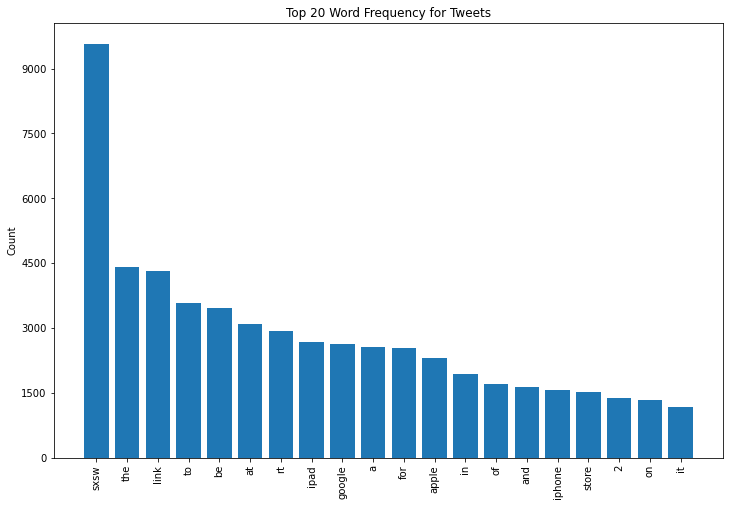

In [28]:
# Visualizing the top 20 word frequency associated with the tweets  
from matplotlib.ticker import MaxNLocator

def visualize_top_20(freq_dist, title):

    # Extract data for plotting
    top_20 = list(zip(*freq_dist.most_common(20)))
    tokens = top_20[0]
    counts = top_20[1]

    # Set up plot and plot data
    fig, ax = plt.subplots(figsize =(12,8))
    ax.bar(tokens, counts)

    # Customize plot appearance
    ax.set_title(title)
    ax.set_ylabel("Count")
    ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    ax.tick_params(axis="x", rotation=90)
    
visualize_top_20(freq_dist, "Top 20 Word Frequency for Tweets")

From the bargraph above, we observe that the top occuring words are dominated by stop words. As such, these need to be removed before proceeding further.

In [29]:
# Load stopwords for English
stop_words = set(stopwords.words('english'))


# Remove stopwords from the tokens
tokens_finalised = [word for word in tokens_lemmatized if word.lower() not in stop_words]

In [30]:
freq_dist_2 = FreqDist(tokens_finalised)
freq_dist_2


FreqDist({'sxsw': 9576, 'link': 4313, 'rt': 2942, 'ipad': 2675, 'google': 2633, 'apple': 2316, 'iphone': 1574, 'store': 1518, '2': 1374, 'new': 1088, ...})

C:\Users\HP\anaconda3\envs\learn-env\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 137 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\HP\anaconda3\envs\learn-env\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 137 missing from current font.
  font.set_text(s, 0, flags=flags)


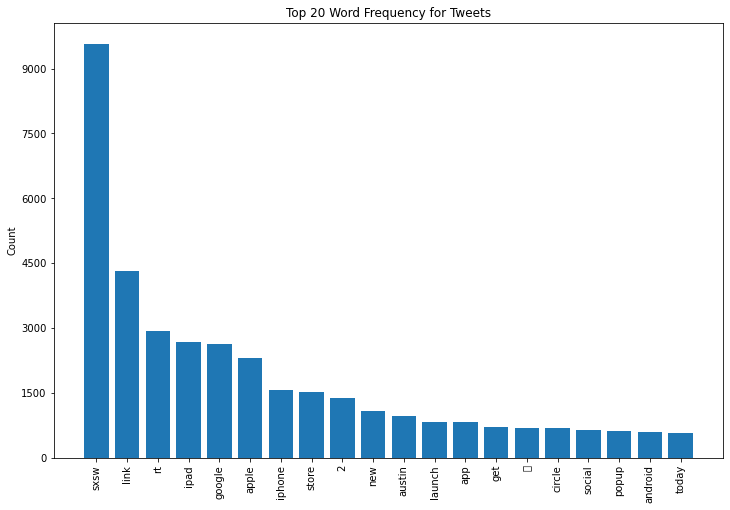

In [31]:
# Visualizing the top 20 word frequency associated with the tweets  
from matplotlib.ticker import MaxNLocator


def visualize_top_20(freq_dist_2, title):

    # Extract data for plotting
    top_20 = list(zip(*freq_dist_2.most_common(20)))
    tokens = top_20[0]
    counts = top_20[1]

    # Set up plot and plot data
    fig, ax = plt.subplots(figsize =(12,8))
    ax.bar(tokens, counts)

    # Customize plot appearance
    ax.set_title(title)
    ax.set_ylabel("Count")
    ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    ax.tick_params(axis="x", rotation=90)
    
visualize_top_20(freq_dist_2, "Top 20 Word Frequency for Tweets")

We still have words such as **sxsw**, which is the name of the festival, as well as twitter words such as **link** and **rt**. In addition, here is a special character "\x89" that appears in our data as well as single value entries. Finally, there is a number `2` that it's most likely referring to the **iPad 2** which was been launched at the time.All these entries would need to be removed as they would not be adding value to our analysis. To do so, will use `Regular Expressions`  to remove the special characters, numbers and all single entries from our list.

In [32]:
#Introducing RegEx pattern to remove \,numbers, single entries
pattern = r"^\\|^.$|^\d+$"

# Remove stopwords from the tokens
tokens_finalised= [word for word in tokens_finalised if not re.match(pattern, word)]

# Remove sxsw, RT and link

stop_list = ["sxsw", "link", "rt"]

tokens_final = [word for word in tokens_finalised if word not in stop_list]

In [33]:
freq_dist_3 = FreqDist(tokens_final)
freq_dist_3

FreqDist({'ipad': 2675, 'google': 2633, 'apple': 2316, 'iphone': 1574, 'store': 1518, 'new': 1088, 'austin': 959, 'launch': 825, 'app': 819, 'get': 702, ...})

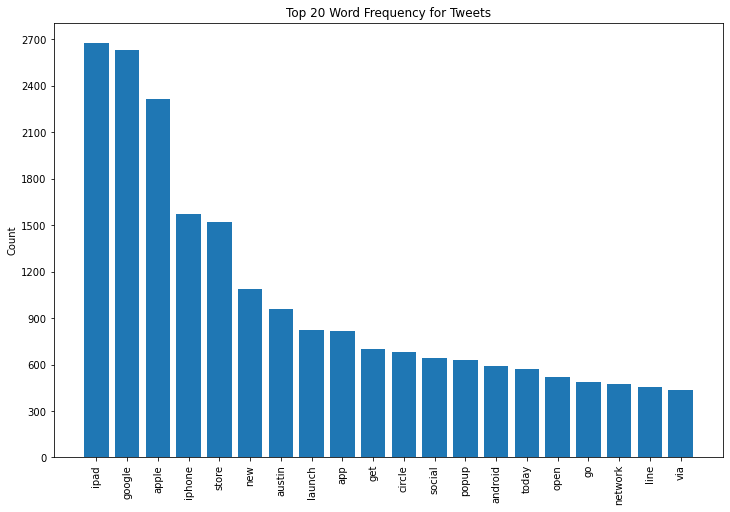

In [34]:
# Visualizing the top 20 word frequency associated with the tweets  
from matplotlib.ticker import MaxNLocator


def visualize_top_20(freq_dist_3, title):

    # Extract data for plotting
    top_20 = list(zip(*freq_dist_3.most_common(20)))
    tokens = top_20[0]
    counts = top_20[1]

    # Set up plot and plot data
    fig, ax = plt.subplots(figsize =(12,8))
    ax.bar(tokens, counts)

    # Customize plot appearance
    ax.set_title(title)
    ax.set_ylabel("Count")
    ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    ax.tick_params(axis="x", rotation=90)
    
visualize_top_20(freq_dist_3, "Top 20 Word Frequency for Tweets")

Much better now. Our text data now contains ipad as the most fequent word followed by google. We can now create a function below that does all these steps to the `Tweet` column of our dataframe listed as follows:

 - instantiate tokenizer
 - remove hashtags and accents
 - remove punctuation marks
 - map NLTK POS tags to WordNet POS tags
 - instantiate lemmatizer
 - Perform POS tagging and lemmatize based on POS
 - Remove stopwords from the tokens, words from our stop list and special characters

In [35]:
def custom_tokenize_2(text):
    # Ensure input is a string
    if isinstance(text, list):
        text = ' '.join(map(str, text))  # Convert list to a single string
    elif not isinstance(text, str):
        raise ValueError(f"Expected string or list, but got {type(text)}")

    # Instantiate tokenizer
    tokenizer = TweetTokenizer(
        preserve_case=False,
        strip_handles=True
    )
    
    # Create list of tokens from the text
    tokens = tokenizer.tokenize(text)
    
    # Process tokens
    tokens = [remove_accents(word) for word in tokens if not word.startswith('#')] + \
             [remove_accents(word[1:]) for word in tokens if word.startswith('#')]
    
    # Remove punctuation marks
    tokens_cleaned = [word.translate(str.maketrans('', '', string.punctuation)) 
                      for word in tokens if word.translate(str.maketrans('', '', string.punctuation))]
    
    # Remove stop words
    tokens_finalised = [word for word in tokens_cleaned if word.lower() not in stop_words]
    
    # Introduce RegEx pattern to remove \, numbers, single entries
    pattern = r"^\\|^.$|^\d+$"
    tokens_finalised = [word for word in tokens_finalised if not re.match(pattern, word)]
    
    # Remove specific words like "sxsw", "RT", and "link"
    stop_list = ["sxsw", "link", "rt"]
    tokens_final = [word for word in tokens_finalised if word not in stop_list]
    
    # Map NLTK POS tags to WordNet POS tags
    def get_wordnet_pos(tag):
        if tag.startswith('J'):
            return wordnet.ADJ
        elif tag.startswith('V'):
            return wordnet.VERB
        elif tag.startswith('N'):
            return wordnet.NOUN
        elif tag.startswith('R'):
            return wordnet.ADV
        else:
            return wordnet.NOUN  # Default to NOUN
    
    # Instantiate lemmatizer
    lemmatizer = WordNetLemmatizer()
    
    # Perform POS tagging and lemmatize based on POS
    tokens_lemmatized = [
        lemmatizer.lemmatize(word, get_wordnet_pos(pos)) for word, pos in pos_tag(tokens_final)
    ]
    
    return tokens_lemmatized

In [36]:
df.data['Tweet_tokens'] = df.data['Tweet'].apply(custom_tokenize_2)

Great! Our dataset is now ready for Exploratory Data Analysis.

In [37]:
#Preview of our finalised dataset

df.data.style.set_properties(**{'text-align': 'left'})

In [38]:
#Drop Product_Name, Product and Tweet columns to generate our finalised_df
final_df = df.data.drop(["Product_Name","Product","Tweet"], axis = 1)
final_df.style.set_properties(**{'text-align': 'left'})

 ## Exploratory Data Analysis
 
 

### Sentiment Distribution

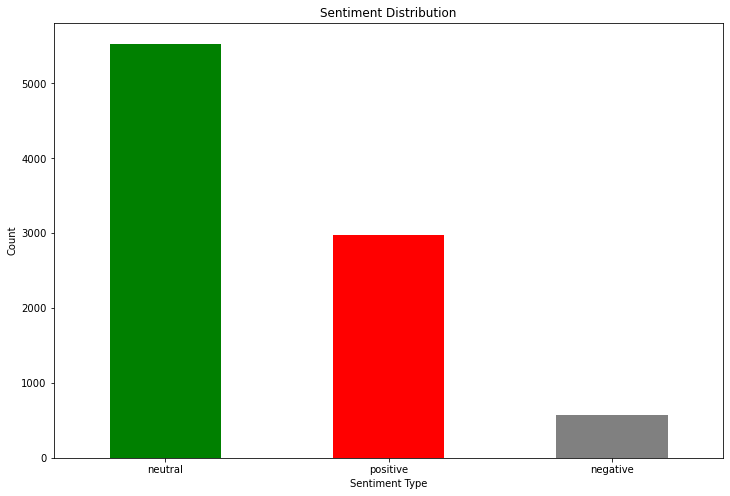

In [39]:
# Count sentiment occurrences
sentiment_counts = final_df['Sentiment_Type'].value_counts()

# Create a pie chart or bar graph for sentiment comparison
plt.figure(figsize=(12, 8))
sentiment_counts.plot(kind='bar', color=['green', 'red', 'gray'])
plt.title('Sentiment Distribution')
plt.xlabel('Sentiment Type')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()

**Observation**: From the sentiment distribution above, we can observe that neutral has the highest count followed by positive sentiments with negative having the lowest counts. This implies  that fewer users expressed dissatisfaction or unfavourable opinions while majority of the users neither expressed strong positivity or negativity.

### Distribution of brands

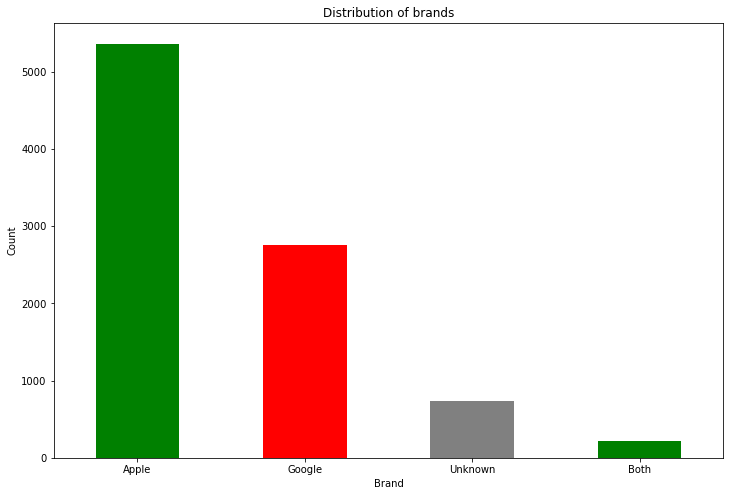

In [40]:
# Count sentiment occurrences
brand_counts = final_df['Brand'].value_counts()

# Create a pie chart or bar graph for sentiment comparison
plt.figure(figsize=(12, 8))
brand_counts.plot(kind='bar', color=['green', 'red', 'gray'])
plt.title('Distribution of brands')
plt.xlabel('Brand')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()

**Observation**: From the distribution above, Apple had the highest response counts with more than 5,000 tweets directed at it. Google, came in second with roughly 3,000 tweets mentioning it. Interestingly, tweets which didn't mention any of the brands were higher than those which mentioned both. Apple had a much better response compared to Google. We can assume that they had more products on display or their products were slightly better hence eliciting more better response.


### Sentiment Distribution by Brand

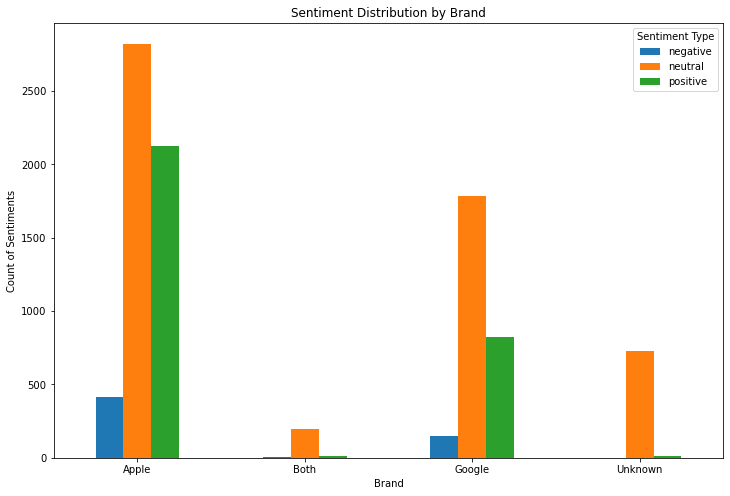

In [41]:
# Group by Brand and Sentiment_Type to count occurrences
sentiment_counts = final_df.groupby(['Brand', 'Sentiment_Type']).size().unstack(fill_value=0)

# Plotting the bar graph
sentiment_counts.plot(kind='bar', stacked=False, figsize=(12, 8))

# Adding titles and labels
plt.title('Sentiment Distribution by Brand')
plt.xlabel('Brand')
plt.ylabel('Count of Sentiments')
plt.xticks(rotation=0)
plt.legend(title='Sentiment Type')

# Show the plot
plt.show()


**Observation**: From the graph above, it fairly consistent among all the brands that neutral sentiment supersedes all the other sentiments. In the case of Apple and Google, positive sentiments are higher than negative sentiments. Also, the proportions of neutral sentiment to positive or negative sentiments is much higher in the `Unknown` category. Apple faired much better in terms of positive sentiments when compared to Google. 


### Top Words per Sentiment

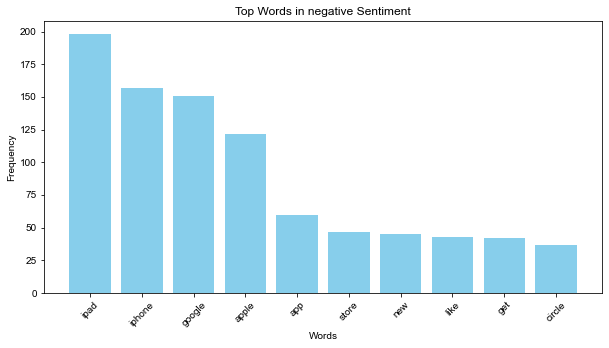

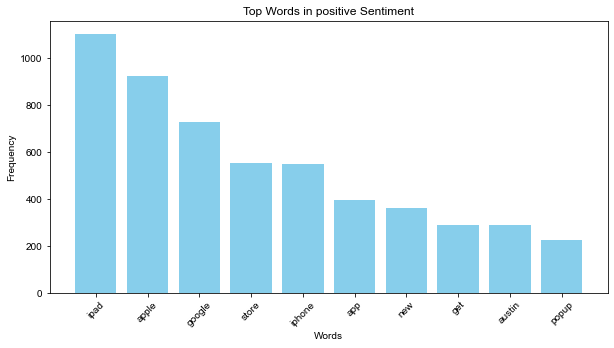

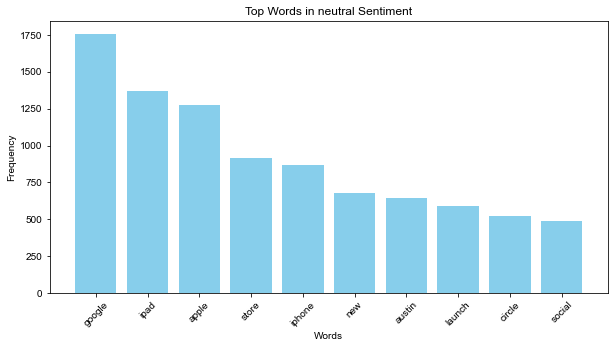

In [42]:
# Flatten the list of words grouped by Sentiment_Type
plt.rcParams['font.family'] = 'Arial'

def get_word_frequencies(final_df, sentiment):
    tokens = final_df[final_df['Sentiment_Type'] == sentiment]['Tweet_tokens']
    all_words = [word for tokens_list in tokens for word in tokens_list]
    return Counter(all_words)

# Define sentiments
sentiments = final_df['Sentiment_Type'].unique()

# Plot the top words for each sentiment type
for sentiment in sentiments:
    # Get word frequencies for this sentiment
    word_freq = get_word_frequencies(final_df, sentiment)
    
    # Get the top 10 most common words
    top_words = word_freq.most_common(10)
    
    # Create a bar chart
    words, counts = zip(*top_words)
    plt.figure(figsize=(10, 5))
    plt.bar(words, counts, color='skyblue')
    plt.title(f'Top Words in {sentiment} Sentiment')
    plt.xlabel('Words')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.show()


**Observation**: From the graphs above, `ipad` is the most common word amongst the positive and negative sentiments. On the other hand, `google` is the most common word amongst people who had a neutral sentiment. This pattern may indicate that Apple's products, particularly the iPad, evoked stronger emotional reactions (positive or negative), whereas Google was discussed in a more neutral tone.

## Feature Engineering


### Convert tokenized data to strings

As part of preprocessing, we will start by converting the lemmatized tokens into strings storing them in a new column `Processed_Tweets` 

In [43]:
# Convert the tokenized column to a single string per row
final_df['Processed_Tweets'] = final_df['Tweet_tokens'].apply(lambda tokens: ' '.join(tokens))
final_df.head()

,Sentiment_Type,Brand,Tweet_tokens,Processed_Tweets
0,negative,Apple,"[3g, iphone, hr, tweet, dead, need, upgrade, p...",3g iphone hr tweet dead need upgrade plugin st...
1,positive,Apple,"[know, awesome, ipad, iphone, app, youll, like...",know awesome ipad iphone app youll likely appr...
2,positive,Apple,"[wait, also, sale, ipad]",wait also sale ipad
3,negative,Apple,"[hope, year, festival, isnt, crashy, year, iph...",hope year festival isnt crashy year iphone app
4,positive,Google,"[great, stuff, fri, marissa, mayer, google, ti...",great stuff fri marissa mayer google tim oreil...


### Create new columns and dataframe

We will create a new dataframe `binary_df` that captures only the `negative` and `positive` sentiments. We would like to perform this analysis in two steps:
1. **Binary classification** - Analyzes only Positive and Negative sentiments
2. **Multiclass classification** - Analyzes Positive, Negative and Neutral sentiments

In addition, a new_column `y_binary` has been created in this data with `positive` sentiments being labelled 1 and `negative` sentiments labelled 0. 

In [44]:
#Perform feature engineering
# Filter the dataset for only positive and negative sentiments
binary_df = final_df[final_df['Sentiment_Type'].isin(['positive', 'negative'])].copy()

# Prepare target variable (1 for positive, 0 for negative)
binary_df["y_binary"] = binary_df['Sentiment_Type'].apply(lambda x: 1 if x == 'positive' else 0)

binary_df

,Sentiment_Type,Brand,Tweet_tokens,Processed_Tweets,y_binary
0,negative,Apple,"[3g, iphone, hr, tweet, dead, need, upgrade, p...",3g iphone hr tweet dead need upgrade plugin st...,0
1,positive,Apple,"[know, awesome, ipad, iphone, app, youll, like...",know awesome ipad iphone app youll likely appr...,1
2,positive,Apple,"[wait, also, sale, ipad]",wait also sale ipad,1
3,negative,Apple,"[hope, year, festival, isnt, crashy, year, iph...",hope year festival isnt crashy year iphone app,0
4,positive,Google,"[great, stuff, fri, marissa, mayer, google, ti...",great stuff fri marissa mayer google tim oreil...,1
...,...,...,...,...,...
9077,positive,Apple,"[pr, guy, convince, switch, back, iphone, grea...",pr guy convince switch back iphone great cover...,1
9079,positive,Apple,"[papyrus, sort, like, ipad, nice, lol, lavelle]",papyrus sort like ipad nice lol lavelle,1
9080,negative,Google,"[diller, say, google, tv, might, run, playstat...",diller say google tv might run playstation xbo...,0
9085,positive,Apple,"[ive, always, use, camera, iphone, image, stab...",ive always use camera iphone image stabilizer ...,1


### Check for imbalance

Given, the binary classification problem, let's check for class imbalance in the target variable `y_binary`.
As can be observed below, we do have a clear imbalance in our target variable`y_binary`. Therefore if we had a model that always picked people that had a positive sentiment (majority class) then we would expect an accuracy score of around 83%. This class imbalance issue will be looked at as part of building the model.

In [45]:
#Checking for imbalance in the target variable

print(binary_df["y_binary"].value_counts())
print("\n-----------------")
print(binary_df["y_binary"].value_counts(normalize=True))


1    2970
0     569
Name: y_binary, dtype: int64

-----------------
1    0.83922
0    0.16078
Name: y_binary, dtype: float64


### Perform a train-test split

Create variables `X_train`, `X_test`, `y_train`, and `y_test` using train_test_split with `X`, `y`, `test_size` =0.3, and `random_state`=42.

In [46]:
#Define our X and y variables

X= binary_df["Processed_Tweets"]
y =binary_df["y_binary"]

#Perform train_test_split

X_train, X_test, y_train, y_test = train_test_split (X, y, test_size=0.3, random_state =42)

## Modelling 

### Binary Classification

We will begin with a binary classification with the focus being on only `positive` and `negative` sentiments

### Baseline Model
Our baseline model will be the Multinomial Naive Bayes (NB) classifier. Given the size of our dataset, this model is particularly well-suited due to its efficiency and effectiveness in handling text data represented as word frequencies or TF-IDF features. It assumes a multinomial distribution for features, which aligns well with the nature of text, where word occurrences are critical indicators of sentiment. Its computational simplicity makes it ideal for medium-sized datasets  allowing for quick training and evaluation. Furthermore, it performs well with sparse data, typical in text analysis, where most words in the vocabulary do not appear in every document. The probabilistic nature of Multinomial NB also provides interpretable outputs, enabling insights into which words are most associated with each sentiment class. Despite its simplicity, it can achieve competitive results and serves as a strong baseline for sentiment analysis.


### Create a pipeline

Create a pipeline that TF-IDF vectorizes text input and then feeds it into a Multinomial Naive Bayes classifier with `max_features` =10 as a start. This pipeline has been saved as a variable **nlp_pipe**.

In [47]:
# Create a pipeline iwth TF-IDF vectorizer and MultiNomial Naive Bayes Classifier

nlp_pipe = Pipeline([
    ("tfidf", TfidfVectorizer(max_features=10)),
    ("classifier", MultinomialNB())
  
])

In [48]:
#Fit the pipe to the training data and predict using the test data
nlp_pipe.fit(X_train,y_train)
y_pred_baseline = nlp_pipe.predict(X_test)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred_baseline)
precision = precision_score(y_test, y_pred_baseline, average='weighted', zero_division=0)
recall = recall_score(y_test,y_pred_baseline, average='weighted')
f1 = f1_score(y_test,y_pred_baseline, average='weighted')

# Print results
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


Accuracy: 0.8502824858757062
Precision: 0.7229803057869705
Recall: 0.8502824858757062
F1-score: 0.7814810022857634


Our baseline model performs slightly better with an accuracy of 85% when compared to selecting the majority class most of the time. However, with the low precision score, it seems our model still misclassifies most of the negative sentiments.

### Performing  a Grid Search for best parameters
Let's perform a grid search to modify our parameters in the TF-IDF vectorizer as well as the classifier and check if they will give us much better results.

In [49]:
# Define the parameter grid for GridSearchCV
param_grid = {
    'tfidf__max_features': [10, 50, 100, None], # No of features to include when building the TF-IDF representation
    'tfidf__ngram_range': [(1, 1), (1, 2)], #Range of n-grams (sequence of words) considered in the TF-IDF Vectorization process
    'classifier__alpha': [0.1, 1, 10] #Smoothing parameter for the Naive Bayes Classifier
}

# Instantiate GridSearchCV
grid_nb = GridSearchCV(nlp_pipe, param_grid=param_grid, scoring="accuracy", cv=5)

# Fit the grid search
grid_nb.fit(X_train, y_train)

# Get the best estimator
best_model = grid_nb.best_estimator_

# Display the best parameters
print("Best Parameters:", grid_nb.best_params_)
print("Best Score:", grid_nb.best_score_)


Best Parameters: {'classifier__alpha': 0.1, 'tfidf__max_features': None, 'tfidf__ngram_range': (1, 2)}
Best Score: 0.8720259042033236


### Tuned Mutinominal NB model  with best parameters as per the GridSearch
Our tuned NB model will be the `best_model` with the best parameters as per the grid search. We will now refit the train data to this model and see if our evaluation scores improve.

In [50]:
# Refit to train
best_model.fit(X_train,y_train)

# Test set predictions and scores
y_best_pred = best_model.predict(X_test)
tuned_test_acc = accuracy_score(y_test,y_best_pred)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_best_pred)
precision = precision_score(y_test, y_best_pred, average='weighted', zero_division=0)
recall = recall_score(y_test,y_best_pred, average='weighted')
f1 = f1_score(y_test,y_best_pred, average='weighted')

# Print results
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

Accuracy: 0.8879472693032016
Precision: 0.8800182754644669
Recall: 0.8879472693032016
F1-score: 0.8675334922037469


All our evaluation scores have improved when compared to the baseline model scores. Precision and Recall both have gone up to roughly 88% leading to an improvement in the F1-score to 86%. This model does a much better job at classifying the sentiments.

### Multinomial NB model  with Oversampling

Remember as part of pre-processing we had a look at the target variable `y_binary` and it was imbalanced. We will try and use `SMOTE` oversampling technique to handle the imbalance and check if our model scores improve. To do so we will add this into our pipe and rename this variable **nlp_pipe_2**

In [51]:
# Create SMOTE object
smote = SMOTE(random_state=42)

#Pipe
nlp_pipe_2  = Pipeline([
    ("tfidf", TfidfVectorizer(max_features=10)),
    ("smote",SMOTE(random_state=42)),
    ("classifier", MultinomialNB())
  
])

nlp_pipe_2.fit(X_train,y_train)
y_pred_smote = nlp_pipe_2.predict(X_test)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred_smote)
precision = precision_score(y_test, y_pred_smote, average='weighted', zero_division=0)
recall = recall_score(y_test,y_pred_smote, average='weighted')
f1 = f1_score(y_test,y_pred_smote, average='weighted')

# Print results
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

Accuracy: 0.532015065913371
Precision: 0.808025166923472
Recall: 0.532015065913371
F1-score: 0.5948413572728894


Our evaluation scores have gone down when we fit the baseline model parameters to the oversampled data. Only precision is within our range at 80% while the recall is at 53%. This means that the model will misclassify a lot of the positive sentiments as negative which is ideally what we do not want.

### Tuned MultiNomial NB model with Oversampling incorporating best parameters

Given the outcome above, we will perform a similar grid search to find the optimal parameters

In [52]:
# Define the parameter grid for GridSearchCV
param_grid = {
    'tfidf__max_features': [10, 50, 100, None], # No of features to include when building the TF-IDF representation
    'tfidf__ngram_range': [(1, 1), (1, 2)], #Range of n-grams (sequence of words) considered in the TF-IDF Vectorization process
    'classifier__alpha': [0.1, 1, 10]       #Smoothing parameter for the Naive Bayes Classifier
}

# Instantiate GridSearchCV
grid_nb_smote = GridSearchCV(nlp_pipe_2, param_grid=param_grid, scoring="accuracy", cv=5)

# Fit the grid search
grid_nb_smote.fit(X_train, y_train)

# Get the best estimator
best_model_smote = grid_nb_smote.best_estimator_

# Display the best parameters
print("Best Parameters:", grid_nb_smote.best_params_)
print("Best Score:", grid_nb_smote.best_score_)

Best Parameters: {'classifier__alpha': 0.1, 'tfidf__max_features': None, 'tfidf__ngram_range': (1, 2)}
Best Score: 0.8369053437601824


In [53]:
#Refit to train
best_model_smote.fit(X_train,y_train)

# Test set predictions and scores
y_best_pred_smote = best_model_smote.predict(X_test)

# Calculate evaluation metrics
accuracy_smote = accuracy_score(y_test, y_best_pred_smote)
precision_smote = precision_score(y_test, y_best_pred_smote, average='weighted', zero_division=0)
recall_smote = recall_score(y_test,y_best_pred_smote, average='weighted')
f1_smote = f1_score(y_test,y_best_pred_smote, average='weighted')

# Print results
print("Accuracy:", accuracy_smote)
print("Precision:", precision_smote)
print("Recall:", recall_smote)
print("F1-score:", f1_smote)

Accuracy: 0.844632768361582
Precision: 0.8574459443976136
Recall: 0.844632768361582
F1-score: 0.850176304292659


This performs much better but the `best_model` had the better evaluation results. `Precision` and `Recall` are slightly lower leading to a reduced `F1-score` of 0.85.  Thus, even though we performed oversampling, it did not improve the results of our model as expected. For the Multinomial NB classifier, `best_model` is our best model so far. A confusion matrix on the `best_model` results is shown below:

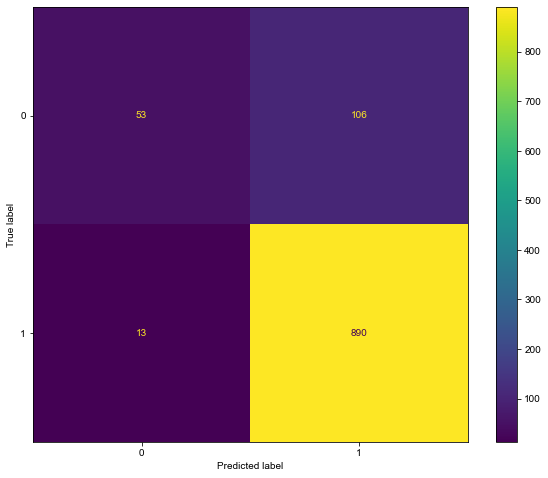

In [54]:
#Confusion matrix on best model using the test data

cnf_matrix = confusion_matrix(y_test,y_best_pred)

# Create a figure with specified size
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust size as needed

# Create and plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cnf_matrix)
disp.plot(ax=ax);


From the confusion matrix above, the model performs well at correctly classifying positive instances(890). There is a moderate number of samples misclassified as positive (106), suggesting room for improvement in precision. The model rarely misses positive samples (13), which is good for recall. Fewer instances (53) are correctly classified as negative, indicating the negative class might be under-represented or harder to classify.

### Neural Network

Based on the results we have observed on the MultiNomial NB model, we will fit a neural network to check if it does a better job at the binary classification.

In [55]:
# Vectorize text data using TF-IDF
vectorizer = TfidfVectorizer(max_features=5000)
X_train_tfidf = vectorizer.fit_transform(X_train).toarray()
X_test_tfidf = vectorizer.transform(X_test).toarray()

# Define the neural network model
model = Sequential([
    Dense(128, input_dim=X_train_tfidf.shape[1], activation='relu'),  # Input layer
    Dropout(0.5),  # Dropout to prevent overfitting
    Dense(64, activation='relu'),  # Hidden layer
    Dropout(0.3),  # Dropout
    Dense(1, activation='sigmoid')  # Output layer for binary classification
])

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train_tfidf, y_train, epochs=10, batch_size=16, validation_split=0.2, verbose=1)

# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(X_test_tfidf, y_test, verbose=0)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")

# Predict on the test set
y_pred = model.predict(X_test_tfidf)
y_pred_binary = (y_pred > 0.5).astype(int).flatten()

# Calculate evaluation metrics
accuracy_nn = accuracy_score(y_test, y_pred_binary)
precision_nn = precision_score(y_test, y_pred_binary, average='weighted', zero_division=0)
recall_nn = recall_score(y_test,y_pred_binary, average='weighted')
f1_nn = f1_score(y_test,y_pred_binary, average='weighted')

# Print results
print("Accuracy:", accuracy_nn)
print("Precision:", precision_nn)
print("Recall:", recall_nn)
print("F1-score:", f1_nn)

Epoch 1/10
124/124 [==============================] - 1s 8ms/step - loss: 0.4817 - accuracy: 0.8304 - val_loss: 0.3812 - val_accuracy: 0.8488
Epoch 2/10
124/124 [==============================] - 1s 6ms/step - loss: 0.3330 - accuracy: 0.8319 - val_loss: 0.3389 - val_accuracy: 0.8589
Epoch 3/10
124/124 [==============================] - 1s 6ms/step - loss: 0.2088 - accuracy: 0.9091 - val_loss: 0.3240 - val_accuracy: 0.8629
Epoch 4/10
124/124 [==============================] - 1s 6ms/step - loss: 0.1001 - accuracy: 0.9672 - val_loss: 0.3723 - val_accuracy: 0.8810
Epoch 5/10
124/124 [==============================] - 1s 10ms/step - loss: 0.0487 - accuracy: 0.9849 - val_loss: 0.4217 - val_accuracy: 0.8790
Epoch 6/10
124/124 [==============================] - 1s 10ms/step - loss: 0.0348 - accuracy: 0.9894 - val_loss: 0.4559 - val_accuracy: 0.8730
Epoch 7/10
124/124 [==============================] - 1s 6ms/step - loss: 0.0231 - accuracy: 0.9934 - val_loss: 0.4950 - val_accuracy: 0.8690
Epoc

### Tuned Neural Network




Tuning the neural network to improve its perfomance. As such we will be changing the parameters as follows:
    
- Increase `hidden Layers`: Add one `hidden layer` to capture complex patterns in the data.
- Increase `epoch size` to 50 to allow the model to learn better while ensuring it does not overfit.
- Changed `batch size` to 8 to allow the model to run on a much smaller batches.



In [56]:
# Vectorize text data using TF-IDF
vectorizer = TfidfVectorizer(max_features=5000)
X_train_tfidf = vectorizer.fit_transform(X_train).toarray()
X_test_tfidf = vectorizer.transform(X_test).toarray()

# Define the neural network model
model = Sequential([
    Dense(128, input_dim=X_train_tfidf.shape[1], activation='relu'),
    Dropout(0.5),
    Dense(128, activation='relu'),  # Additional hidden layer
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])
# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train_tfidf, y_train, epochs=20, batch_size=8, validation_split=0.2, verbose=1)

# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(X_test_tfidf, y_test, verbose=0)
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")

# Predict on the test set
y_pred = model.predict(X_test_tfidf)
y_pred_binary = (y_pred > 0.5).astype(int).flatten()

# Calculate evaluation metrics
accuracy_nn = accuracy_score(y_test, y_pred_binary)
precision_nn = precision_score(y_test, y_pred_binary, average='weighted', zero_division=0)
recall_nn = recall_score(y_test,y_pred_binary, average='weighted')
f1_nn = f1_score(y_test,y_pred_binary, average='weighted')

# Print results
print("Accuracy:", accuracy_nn)
print("Precision:", precision_nn)
print("Recall:", recall_nn)
print("F1-score:", f1_nn)

Epoch 1/20
248/248 [==============================] - 1s 6ms/step - loss: 0.4453 - accuracy: 0.8294 - val_loss: 0.3590 - val_accuracy: 0.8488
Epoch 2/20
248/248 [==============================] - 1s 5ms/step - loss: 0.2738 - accuracy: 0.8718 - val_loss: 0.3371 - val_accuracy: 0.8508
Epoch 3/20
248/248 [==============================] - 1s 6ms/step - loss: 0.1364 - accuracy: 0.9480 - val_loss: 0.4012 - val_accuracy: 0.8306
Epoch 4/20
248/248 [==============================] - 1s 6ms/step - loss: 0.0713 - accuracy: 0.9788 - val_loss: 0.4451 - val_accuracy: 0.8589
Epoch 5/20
248/248 [==============================] - 1s 6ms/step - loss: 0.0397 - accuracy: 0.9859 - val_loss: 0.5119 - val_accuracy: 0.8710
Epoch 6/20
248/248 [==============================] - 1s 5ms/step - loss: 0.0255 - accuracy: 0.9934 - val_loss: 0.5609 - val_accuracy: 0.8690
Epoch 7/20
248/248 [==============================] - 2s 6ms/step - loss: 0.0209 - accuracy: 0.9939 - val_loss: 0.5922 - val_accuracy: 0.8609
Epoch 

The results are almost similar to the neural network that has not been tuned. It's worth noting that the accuracy, precision, recall and F1 score observed from the neural networks are slightly lower than what was observed by our best Multinomial NB model. This is expected as the size of our dataset is quite small. With more data, we believe the neural network will exhibit better results.
Below is a confusion matrix of the neural network model results:

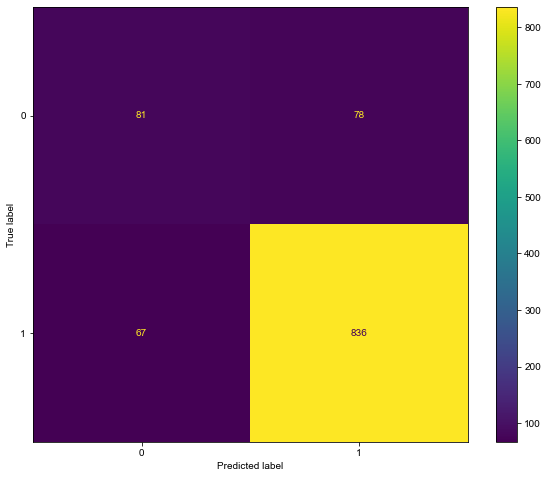

In [57]:
cnf_matrix_nn = confusion_matrix(y_test, y_pred_binary)


# Create a figure with specified size
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust size as needed

# Create and plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cnf_matrix_nn)
disp.plot(ax=ax);


Comparing the confusion matrix above to the MultiNomial NB classifier confusion matrix we note that the number of correctly classified negatives has increased, indicating better performance for the negative class.There are also fewer false positives in the current matrix, indicating better precision. However, the number of false negatives has increased, meaning the model is now missing more actual positive samples, reducing recall. Finally, the number of true positives has decreased, indicating a drop in correctly classified positives.

Therefore the Neural Network model has become better at classifying negative samples, as seen in the increase in true negatives and decrease in false positives. On the other hand, the model's ability to correctly classify positive samples has decreased, evident from the higher false negatives and lower true positives. Thus, recall for the positive class has likely decreased while precision for the negative class has likely improved.

### Multiclass Classification:

Next we perform a similar analysis on a multiclass classification taking into account Positive, Negative and Neutral sentiments

### Preprocessing

#### Label Encode the Target Variable

Given we have three classes to analyze, we will label encode and store them in a new column `Sentiment_Label`. 

In [58]:
#creaeting a multiclass df to be used in our analysis
multi_class_df = final_df.copy()
multi_class_df

# Instantiate LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the Sentiment_Type column
multi_class_df['Sentiment_Label'] = label_encoder.fit_transform(multi_class_df['Sentiment_Type'])

# Display the encoded values
print("Classes:", label_encoder.classes_)  # To see the mapping
multi_class_df['Sentiment_Label'].value_counts()

Classes: ['negative' 'neutral' 'positive']


1    5531
2    2970
0     569
Name: Sentiment_Label, dtype: int64

#### Defining our variables

In [59]:
#Defining our X and y variables

X_multi= multi_class_df["Processed_Tweets"]
y_multi =multi_class_df["Sentiment_Label"]

#Perform train_test_split

X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split (X_multi,y_multi, test_size=0.3, random_state =42)

### Baseline Model

Similarly, we will use a Multinomial NB classifier as our baseline model.

In [60]:
# Create a pipeline iwth TF-IDF vectorizer and MultiNomial Naive Bayes Classifier

nlp_pipe = Pipeline([
    ("tfidf", TfidfVectorizer(max_features=10)),
    ("classifier", MultinomialNB())
  
])

#Fit the pipe to the training data and predict using the test data
nlp_pipe.fit(X_train_multi,y_train_multi)
y_pred_multi_baseline = nlp_pipe.predict(X_test_multi)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test_multi, y_pred_multi_baseline)
precision = precision_score(y_test_multi, y_pred_multi_baseline, average='weighted', zero_division=0)
recall = recall_score(y_test_multi,y_pred_multi_baseline, average='weighted')
f1 = f1_score(y_test_multi,y_pred_multi_baseline, average='weighted')

# Print results
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


Accuracy: 0.6383682469680264
Precision: 0.5698696833224892
Recall: 0.6383682469680264
F1-score: 0.516544364106263


`Accuracy` and `Recall` are roughly 64% with the `Precision` slightly lower at 57%. As a result the F1 score is a bit low at 0.51. all these results are way below our expected value of 85% across all the metrics so we will perform a grid search to tune the hyper parameters and see if we get better results.

### Performing a Grid Search

In [61]:
# Define the parameter grid for GridSearchCV
param_grid = {
    'tfidf__max_features': [10, 50, 100, None], # No of features to include when building the TF-IDF representation
    'tfidf__ngram_range': [(1, 1), (1, 2)], #Range of n-grams (sequence of words) considered in the TF-IDF Vectorization process
    'classifier__alpha': [0.1, 1, 10]       #Smoothing parameter for the Naive Bayes Classifier
}

# Instantiate GridSearchCV
grid_nb_multi = GridSearchCV(nlp_pipe, param_grid=param_grid, scoring="accuracy", cv=5)

# Fit the grid search
grid_nb_multi.fit(X_train_multi, y_train_multi)

# Get the best estimator
best_model_multi = grid_nb_multi.best_estimator_

# Display the best parameters
print("Best Parameters:", grid_nb_multi.best_params_)
print("Best Score:", grid_nb_multi.best_score_)

Best Parameters: {'classifier__alpha': 0.1, 'tfidf__max_features': None, 'tfidf__ngram_range': (1, 2)}
Best Score: 0.6673484608750148


### Tuned MultiNomial NB Model using the best parameters from Grid search

In [62]:
#Refit to train
best_model_multi.fit(X_train_multi,y_train_multi)

# Test set predictions and scores
y_best_pred_multi = best_model_multi.predict(X_test_multi)

# Calculate evaluation metrics
accuracy_multi = accuracy_score(y_test_multi, y_best_pred_multi)
precision_multi = precision_score(y_test_multi, y_best_pred_multi, average='weighted', zero_division=0)
recall_multi = recall_score(y_test_multi,y_best_pred_multi, average='weighted')
f1_multi = f1_score(y_test_multi,y_best_pred_multi, average='weighted')

# Print results
print("Accuracy:", accuracy_multi)
print("Precision:", precision_multi)
print("Recall:", recall_multi)
print("F1-score:", f1_multi)

Accuracy: 0.6795295847115032
Precision: 0.6737743115378796
Recall: 0.6795295847115032
F1-score: 0.668536706918894


Much better! Slight improvement in our metrics even though we are yet to hit our target value. Let's try a different model and see if we can achieve this.

### XGBoost

For this multi-class problem, we will try the `XGBoost` model as it's slightly recommended for dealing with datasets that are slightly larger than ours. Given the neural network did not improve our evaluation scores in our binary classification analysis, it is worth trying it out this time around.

In [63]:
# Create a pipeline with TF-IDF vectorizer and MultiNomial Naive Bayes Classifier

nlp_pipe_xgb = Pipeline([
    ("tfidf", TfidfVectorizer(max_features=10)),
    ("classifier",  XGBClassifier(random_state=42))
  
])

#Fit the pipe to the training data and predict using the test data
nlp_pipe_xgb.fit(X_train_multi,y_train_multi)
y_pred_multi_xgb = nlp_pipe_xgb.predict(X_test_multi)

# Calculate evaluation metrics
accuracy_xgb = accuracy_score(y_test_multi, y_pred_multi_xgb)
precision_xgb = precision_score(y_test_multi, y_pred_multi_xgb, average='weighted', zero_division=0)
recall_xgb = recall_score(y_test_multi,y_pred_multi_xgb, average='weighted')
f1_xgb = f1_score(y_test_multi,y_pred_multi_xgb, average='weighted')

# Print results
print("Accuracy:", accuracy_xgb)
print("Precision:", precision_xgb)
print("Recall:", recall_xgb)
print("F1-score:", f1_xgb)


Accuracy: 0.619625137816979
Precision: 0.5475024753164434
Recall: 0.619625137816979
F1-score: 0.5538110306803976


The metrics are even lower than the baseline MultiNomial NB classifier. It's worth doing tuning the parameters and observing if there is an increase observed.

In [70]:
# Define the parameter grid
param_grid = {
    "tfidf__max_features": [10, 50, 100, None], # No of features to include when building the TF-IDF representation
    "tfidf__ngram_range": [(1, 1), (1, 2)], #Range of n-grams (sequence of words) considered in the TF-IDF Vectorization process
    "classifier__n_estimators": [50, 100, 200],  # Number of trees
    "classifier__max_depth": [3, 5, 7],  # Maximum depth of a tree
    "classifier__learning_rate": [0.01, 0.1, 0.2],  # Learning rate
}

# Define the pipeline
nlp_pipe_xgb = Pipeline([
    ("tfidf", TfidfVectorizer(max_features=10)),
    ("classifier", XGBClassifier(random_state=42))
])

# Create the GridSearchCV object
grid_search = GridSearchCV(
    nlp_pipe_xgb,
    param_grid,
    cv=5,  # 5-fold cross-validation
    scoring="accuracy",  # Use accuracy as the scoring metric
    verbose=1,  # Print progress
    n_jobs=-1  # Use all available cores
)

# Fit the GridSearchCV to the training data
grid_search.fit(X_train_multi, y_train_multi)

# Get the best pipeline
best_pipe_xgb = grid_search.best_estimator_

# Display the best parameters
print("Best Parameters:", grid_search.best_params_)
print("Best Score:", grid_search.best_score_)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'classifier__learning_rate': 0.2, 'classifier__max_depth': 7, 'classifier__n_estimators': 200, 'tfidf__max_features': None, 'tfidf__ngram_range': (1, 2)}
Best Score: 0.6722291096591648


In [71]:
# Predict using the test data
y_pred_multi_xgb = best_pipe_xgb.predict(X_test_multi)

# Calculate evaluation metrics
accuracy_xgb = accuracy_score(y_test_multi, y_pred_multi_xgb)
precision_xgb = precision_score(y_test_multi, y_pred_multi_xgb, average='weighted', zero_division=0)
recall_xgb = recall_score(y_test_multi, y_pred_multi_xgb, average='weighted')
f1_xgb = f1_score(y_test_multi, y_pred_multi_xgb, average='weighted')

# Print results
print("Accuracy:", accuracy_xgb)
print("Precision:", precision_xgb)
print("Recall:", recall_xgb)
print("F1-score:", f1_xgb)



Accuracy: 0.6949650863653068
Precision: 0.6782787740985669
Recall: 0.6949650863653068
F1-score: 0.6745875495615448


This XG boost model has now perfomed much better than the Multinomial NB model. There is still scope for improvement given the accuracy is roughly 70% with the Precision and Recall being 67% and 70% respectively with more data and fine tuning.   

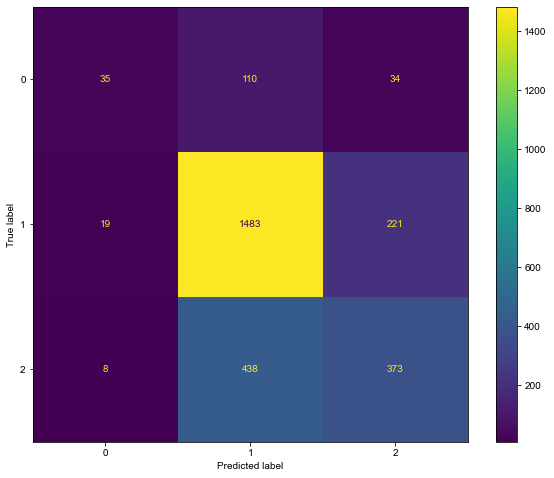

In [69]:
#Generate confusion matrix
cnf_matrix_xgb = confusion_matrix(y_test_multi,y_pred_multi_xgb)


# Create a figure with specified size
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust size as needed

# Create and plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cnf_matrix_xgb)
disp.plot(ax=ax);



As per the confusion matrix above, the model correctly predicted 35 instances of Class 0 (Negative), 1483 instances of Class 1 (Neutral) and  373 instances of Class 2 (Positive). Class 1 (Neutral) has significantly more samples compared to Classes 0 (Negative) and 2 (Positive), leading to dominant predictions for Nuetral class. Misclassification is heavily skewed against the minority classes (positive and negative).Hence a high recall for Neutral class. The model performs well in identifying Neutral class (1483), likely due to its larger representation in the dataset but has challenges with minority Classes. ositive and Negative classes have higher rates of misclassification, with many instances being confused with the Neutral class. This suggests the model struggles with minority classes and may benefit from strategies to handle class imbalance.


## XG Boost with OverSampling

Based on the findings above, we will address the imbalance and see how it affects our model results.

In [73]:
# Define the parameter grid
param_grid = {
    "tfidf__max_features": [10, 50, 100, None], # No of features to include when building the TF-IDF representation
    "tfidf__ngram_range": [(1, 1), (1, 2)], #Range of n-grams (sequence of words) considered in the TF-IDF Vectorization process
    "classifier__n_estimators": [50, 100, 200],  # Number of trees
    "classifier__max_depth": [3, 5, 7],  # Maximum depth of a tree
    "classifier__learning_rate": [0.01, 0.1, 0.2],  # Learning rate
}

# Define the pipeline
nlp_pipe_xgb_2 = Pipeline([
    ("tfidf", TfidfVectorizer(max_features=10)),
    ("smote",SMOTE(random_state=42)),
    ("classifier", XGBClassifier(random_state=42))
])

# Create the GridSearchCV object
grid_search_2 = GridSearchCV(
    nlp_pipe_xgb_2,
    param_grid,
    cv=5,  # 5-fold cross-validation
    scoring="accuracy",  # Use accuracy as the scoring metric
    verbose=1,  # Print progress
    n_jobs=-1  # Use all available cores
)

# Fit the GridSearchCV to the training data
grid_search_2.fit(X_train_multi, y_train_multi)

# Get the best pipeline
best_pipe_xgb_smote = grid_search_2.best_estimator_

# Display the best parameters
print("Best Parameters:", grid_search_2.best_params_)
print("Best Score:", grid_search_2.best_score_)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'classifier__learning_rate': 0.2, 'classifier__max_depth': 7, 'classifier__n_estimators': 200, 'tfidf__max_features': None, 'tfidf__ngram_range': (1, 2)}
Best Score: 0.6712829867897718


In [74]:
# Predict using the test data
y_pred_multi_xgb_smote = best_pipe_xgb_smote.predict(X_test_multi)

# Calculate evaluation metrics
accuracy_xgb_smote = accuracy_score(y_test_multi, y_pred_multi_xgb_smote)
precision_xgb_smote = precision_score(y_test_multi, y_pred_multi_xgb_smote, average='weighted', zero_division=0)
recall_xgb_smote = recall_score(y_test_multi, y_pred_multi_xgb_smote, average='weighted')
f1_xgb_smote = f1_score(y_test_multi, y_pred_multi_xgb_smote, average='weighted')

# Print results
print("Accuracy:", accuracy_xgb_smote)
print("Precision:", precision_xgb_smote)
print("Recall:", recall_xgb_smote)
print("F1-score:", f1_xgb_smote)


Accuracy: 0.6868798235942668
Precision: 0.6693692598388695
Recall: 0.6868798235942668
F1-score: 0.6705368428378342


We see an increase in the precision but a decline in both the accuracy and recall of the model once we oversample. As a result the F1 score has slightly reduced. Oversampling has not really helped in improving our model's prediction.

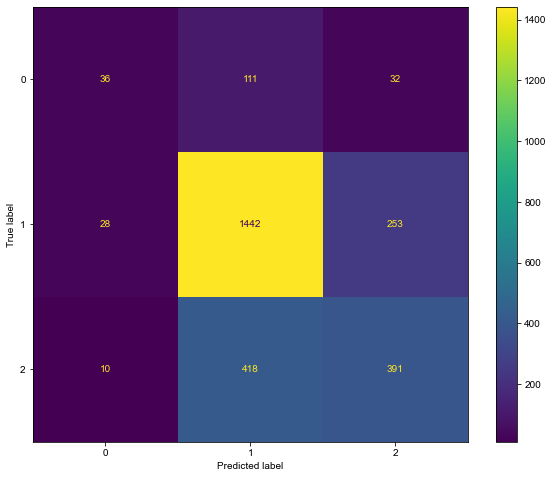

In [75]:
#Generate confusion matrix
cnf_matrix_xgb_smote = confusion_matrix(y_test_multi,y_pred_multi_xgb_smote)


# Create a figure with specified size
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust size as needed

# Create and plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cnf_matrix_xgb_smote)
disp.plot(ax=ax);



As a result of the SMOTE analysis, Class 0 (Negative) and Class 2 (Positive) both show slight improvements in true positive rates. Misclassification of  positive instances as neutral has decreased by 20 cases.
Class 1 (Neutral) sees a noticeable drop in correct classifications (1442 vs. 1483) and an increase in misclassifications into other classes. Misclassifications of Class 1 (Neutral) and Class 2 (Positive) increased significantly (+32 cases).
As a result, the current model slightly balances performance between Classes 0 (Negative) and 2 (Positive) while sacrificing performance for Class 1 (Neutral), indicating a shift in the focus of the model.


## Model Evaluation

#### Binary classification

- We attempted to oversample the data in order to deal with the class imbalance issue. This gave us worse results when we implemented it.

- Our efforts at tuning the models gave us better results when it came to the `MultiNomial NB classifier` but this wasn't the case for `Neural Networks`.

- `MultiNomial NB classifier` was much better when compared to the `Neural Network` when looking at the metrics. As a result `MultiNomial NB classifier` with no oversampling was chosen as the best model. 

#### Multi- class classification

- Similarly, attempts to oversample the data in order to deal with the class imbalance issue gave us worse results when we implemented it.

- The evaluation metrics were quite low in the multi class classification models when compared to the binary classification models

- Our efforts at tuning the models gave us better results for all the models used in this instance.

- `XG Boost` came out as the better model as opposed to the `MultiNomial NB classifier` in modelling the multiclass sentiments. `XG Boost` model with no oversampling  was chosen as the best model for this multi class sentiment analysis. However their evaluation metrics fell short of our targets set out in the success criteria.


## Recommendation

 - **Focus on improving performance for negative sentiment**: Both binary and multi-class classification models struggled with accurately identifying negative sentiment. This could be due to the class imbalance in the dataset, where negative tweets are outnumbered by positive and neutral tweets. Techniques like oversampling or exploring different classification algorithms specifically designed for imbalanced datasets might be beneficial.
 
 
 - **Investigate the impact of SXSW on sentiment**: The data was collected during the SXSW conference, which might not represent typical user sentiment. Consider collecting data from a broader range of sources to get a more comprehensive picture of user opinions.
 
 
 - **Target specific products for analysis**: This analysis focused on sentiment for Apple and Google products in general. Conducting a more granular analysis on specific products (e.g., iPhone vs. Android Phones) could reveal more targeted insights.
 
 
 - **Actionable insights for marketing and product development**: The report suggests that Apple received more attention and positive sentiment compared to Google. It would be beneficial for Apple to understand what drives this positive sentiment.
 
 
 - **Further explore top words by sentiment**: The analysis of top words by sentiment provides a starting point, but a deeper dive could be beneficial. This could help identify underlying themes and topics associated with positive, negative, and neutral sentiment.
 
 
By implementing these recommendations, Apple can gain more valuable insights from their social media data and use them to improve their marketing strategies, product development, and overall customer experience.






## Conclusion

This analysis aimed to build a robust NLP model to classify sentiment in Twitter tweets related to Apple and Google products. Through a comprehensive approach that included data cleaning, exploratory data analysis, and model building (including **Multinomial Naive Bayes**, **Neural Networks**, and **XGBoost**), valuable insights were gained into consumer sentiment.

Key findings include the dominance of neutral sentiment across both brands, a higher proportion of positive sentiment for Apple, and the challenge of accurately classifying negative and positive sentiments, particularly in the multi-class classification.While the **Tuned Multinomial Naive Bayes** model demonstrated strong performance in binary classification, **XGBoost** proved more effective for multi-class classification. However, both models faced challenges in accurately classifying minority sentiment classes.

This analysis provides a foundation for understanding consumer sentiment towards Apple and Google products. Further research, including exploring advanced techniques like deep learning models, incorporating external data sources, and addressing class imbalance more effectively, can further enhance the accuracy and insights derived from this analysis. The findings of this study can be valuable for both Apple in refining their marketing strategies, improving product development, and enhancing customer satisfaction in the competitive tech landscape.


## Next Steps

The next crucial step is to deploy the model for real-world use. To achieve this, the model will be exported into a suitable format (such as a serialized file or a cloud-based API) for seamless integration into software applications. This allows end-users to interact with the model directly, inputting their own text data and receiving sentiment predictions in real-time.

To further enhance predictive performance, exploring alternative models is recommended. Algorithms like Random Forest and Support Vector Machines (SVM) offer different strengths and may provide improved accuracy.

Furthermore, expanding the dataset significantly would enhance model training and overall predictive power. A larger and more diverse dataset would expose the model to a wider range of linguistic patterns and nuances, leading to more robust and accurate predictions.